<img src="../../images/qiskit-heading.gif" alt="Note: In order for images to show up in this jupyter notebook you need to select File => Trusted Notebook" width="500 px\" align="left">

## Interleaved Randomized Benchmarking
---

* **Last Updated:** June 6, 2019
* **Requires:** qiskit-terra 0.8, qiskit-ignis 0.1.1, qiskit-aer 0.2


## Introduction

**Interleved Randomized Benhcmaking** is a variant of the Randomized Benchmarking (RB) method that is used for benchmarking individual Clifford gates via randomization. The protocol consists of interleaving random gates between the given Clifford gate of interest. The protocol estimates the gate error of the given Clifford. 
The method is based on the paper *"Efficient measurement of quantum gate error by interleaved randomized benchmarking"*(https://arxiv.org/abs/1203.4550).

This notebook gives an example for how to use the ``ignis.verification.randomized_benchmarking`` module in order to perform interleaved RB.

In [1]:
#Import general libraries (needed for functions)
import numpy as np
import matplotlib.pyplot as plt
from IPython import display

#Import the RB Functions
import qiskit.ignis.verification.randomized_benchmarking as rb

#Import Qiskit classes classes
import qiskit
from qiskit.providers.aer.noise import NoiseModel
from qiskit.providers.aer.noise.errors.standard_errors import depolarizing_error, thermal_relaxation_error

## Select the Parameters of the Interleaved RB Run

First, wee need to choose the regular RB parameters:

- **nseeds:** The number of seeds. For each seed there you will get a separate list of output circuits in rb_circs.
- **length_vector:** The length vector of Clifford lengths. Must be in ascending order. RB sequences of increasing length grow on top of the previous sequences.
- **rb_pattern:** A list of the form [[i,j],[k],...] which will make simultaneous RB sequences where Qi,Qj are a 2-qubit RB sequence and Qk is a 1-qubit sequence, etc. The number of qubits is the sum of the entries. For 'regular' RB the qubit_pattern is just [[0]],[[0,1]].
- **length_multiplier:** If this is an array it scales each rb_sequence by the multiplier.
- **seed_offset:** What to start the seeds at (e.g. if we want to add more seeds later)
- **align_cliffs:**  If true adds a barrier across all qubits in rb_pattern after each set of cliffords 

As well as another parameter for interleaved RB:
- **interleaved_gates:** A list of gates of Clifford elements that will be interleaved. The length of the list would equal the length of the rb_pattern.

In this example we have 3 qubits Q0,Q1,Q2. 
We are running 2Q RB (on qubits Q0,Q2) and 1Q RB (on qubit Q1) simultaneously, 
where there are twice as many 1Q Clifford gates.

In [2]:
#Number of qubits
nQ = 3
#There are 3 qubits: Q0,Q1,Q2.
#Number of seeds (random sequences)
nseeds = 5
#Number of Cliffords in the sequence (start, stop, steps)
nCliffs = np.arange(1,200,20)
#2Q RB on Q0,Q2 and 1Q RB on Q1
rb_pattern = [[0,2],[1]]
#Do three times as many 1Q Cliffords
length_multiplier = [1,3]
#Interleaved Clifford gates (2-qubits and 1-qubit)
interleaved_gates = [['h 0', 'cx 0 1'],['x 0']]

## Generate Interleaved RB sequences

We generate RB sequences. We start with a small example (so it doesn't take too long to run).

In order to generate the RB sequences **rb_circs**, which is a list of lists of quantum circuits, 
we run the function **rb.randomized_benchmarking_seq**.

This function returns:

- **rb_original_circs:** A list of lists of circuits for the original rb sequences (separate list for each seed).
- **xdata:** The Clifford lengths (with multiplier if applicable).
- **rb_opts_dict:** Option dictionary back out with default options appended.

As well as:
- **rb_interleaved_circs**: A list of lists of circuits for the interleaved rb sequences (separate list for each seed).

In [3]:
rb_opts = {}
rb_opts['length_vector'] = nCliffs
rb_opts['nseeds'] = nseeds
rb_opts['rb_pattern'] = rb_pattern
rb_opts['length_multiplier'] = length_multiplier
#rb_opts['align_cliffs'] = True
rb_opts['interleaved_gates'] = interleaved_gates
rb_original_circs, xdata, rb_interleaved_circs = rb.randomized_benchmarking_seq(**rb_opts)

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.re

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.re

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.re

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.re

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or 

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or 

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit a

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or 

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use q

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: Deprecatio

/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or 

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/randomized_benchmarking/circuits.py:343: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  (qr, q_nums[x]) for x in [arg[1] for arg in qargs]]
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr, 0), use qr[0].
  'Instead go of (qr, 0), use qr[0].', DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/circuit/quantumcircuit.py:42: DeprecationWarning: Referring to a bit as a tuple is being deprecated. Instead go of (qr

As an example, we print the circuit corresponding to the first original and interleaved RB sequences:

In [4]:
#Original RB circuits
print (rb_original_circs[0][0])

         ┌───┐┌───┐┌───┐          ┌───┐   ┌─────┐┌───┐ ░      ┌───┐┌───┐┌───┐»
qr_0: |0>┤ H ├┤ H ├┤ S ├──■───────┤ X ├───┤ Sdg ├┤ H ├─░──────┤ H ├┤ S ├┤ X ├»
         ├───┤├───┤├───┤  │  ┌───┐└─┬─┘ ░ └┬───┬┘├───┤ ░ ┌───┐└─░─┘├───┤└─┬─┘»
qr_1: |0>┤ H ├┤ H ├┤ S ├──┼──┤ Z ├──┼───░──┤ H ├─┤ S ├───┤ Y ├──░──┤ H ├──┼──»
         └───┘└───┘└───┘┌─┴─┐└───┘  │   ░  ├───┤ └───┘ ░ └───┘┌───┐└───┘  │  »
qr_2: |0>───────────────┤ X ├───────■──────┤ X ├───────░──────┤ X ├───────■──»
                        └───┘              └───┘       ░      └───┘          »
 cr_0: 0 ════════════════════════════════════════════════════════════════════»
                                                                             »
 cr_1: 0 ════════════════════════════════════════════════════════════════════»
                                                                             »
 cr_2: 0 ════════════════════════════════════════════════════════════════════»
                                                    

In [5]:
#Interleaved RB circuits
print (rb_interleaved_circs[0][0])

         ┌───┐┌───┐┌───┐          ┌───┐   ┌─────┐┌───┐ ░      ┌───┐          »
qr_0: |0>┤ H ├┤ H ├┤ S ├──■───────┤ X ├───┤ Sdg ├┤ H ├─░──────┤ H ├──■───────»
         ├───┤├───┤├───┤  │  ┌───┐└─┬─┘ ░ └┬───┬┘└─░─┘ ░ ┌───┐├───┤  │  ┌───┐»
qr_1: |0>┤ H ├┤ H ├┤ S ├──┼──┤ Z ├──┼───░──┤ X ├───░─────┤ H ├┤ S ├──┼──┤ Y ├»
         └───┘└───┘└───┘┌─┴─┐└───┘  │   ░  ├───┤   ░   ░ └───┘└───┘┌─┴─┐└───┘»
qr_2: |0>───────────────┤ X ├───────■──────┤ X ├───────░───────────┤ X ├─────»
                        └───┘              └───┘       ░           └───┘     »
 cr_0: 0 ════════════════════════════════════════════════════════════════════»
                                                                             »
 cr_1: 0 ════════════════════════════════════════════════════════════════════»
                                                                             »
 cr_2: 0 ════════════════════════════════════════════════════════════════════»
                                                    

## Define the noise model

We define a noise model for the simulator. To simulate decay, we add depolarizing error probabilities to the CNOT and U gates.

In [6]:
noise_model = NoiseModel()
p1Q = 0.002
p2Q = 0.01
noise_model.add_all_qubit_quantum_error(depolarizing_error(p1Q, 1), 'u2')
noise_model.add_all_qubit_quantum_error(depolarizing_error(2*p1Q, 1), 'u3')
noise_model.add_all_qubit_quantum_error(depolarizing_error(p2Q, 2), 'cx')

We can execute the original and interleaved RB sequences either using Qiskit Aer Simulator (with some noise model) or using IBMQ provider, and obtain a list of results result_list.

In [7]:
#Original RB circuits
backend = qiskit.Aer.get_backend('qasm_simulator')
basis_gates = ['u1','u2','u3','cx'] # use U,CX for now
shots = 200
original_result_list = []
original_qobj_list = []
import time
for rb_seed,rb_circ_seed in enumerate(rb_original_circs):
    print('Compiling seed %d'%rb_seed)
    new_rb_circ_seed = qiskit.compiler.transpile(rb_circ_seed, basis_gates=basis_gates)
    qobj = qiskit.compiler.assemble(new_rb_circ_seed, shots=shots)
    print('Simulating seed %d'%rb_seed)
    job = backend.run(qobj, noise_model=noise_model, backend_options={'max_parallel_experiments': 0})
    original_result_list.append(job.result())
    original_qobj_list.append(qobj)    
print("Finished Simulating Original Circuits")

Compiling seed 0
Simulating seed 0


/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)


Compiling seed 1
Simulating seed 1


/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)


Compiling seed 2
Simulating seed 2


/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)


Compiling seed 3
Simulating seed 3


/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)


Compiling seed 4
Simulating seed 4


/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)


Finished Simulating Original Circuits


/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationWarning)
/gpfs/haifa/projects/q/qq/team/shelly/terra/qiskit/validation/base.py:360: DeprecationWarning: The as_dict() method is deprecated, use to_dict().
  DeprecationW

In [8]:
#Interleaved RB circuits
backend = qiskit.Aer.get_backend('qasm_simulator')
basis_gates = ['u1','u2','u3','cx'] # use U,CX for now
shots = 200
interleaved_result_list = []
interleaved_qobj_list = []
import time
for rb_seed,rb_circ_seed in enumerate(rb_interleaved_circs):
    print('Compiling seed %d'%rb_seed)
    new_rb_circ_seed = qiskit.compiler.transpile(rb_circ_seed, basis_gates=basis_gates)
    qobj = qiskit.compiler.assemble(new_rb_circ_seed, shots=shots)
    print('Simulating seed %d'%rb_seed)
    job = backend.run(qobj, noise_model=noise_model, backend_options={'max_parallel_experiments': 0})
    interleaved_result_list.append(job.result())
    interleaved_qobj_list.append(qobj)    
print("Finished Simulating Interleaved Circuits")

Compiling seed 0
Simulating seed 0
Compiling seed 1
Simulating seed 1
Compiling seed 2
Simulating seed 2
Compiling seed 3
Simulating seed 3
Compiling seed 4
Simulating seed 4
Finished Simulating Interleaved Circuits


## Fit the results

We fit the results of the original RB circuits and the interleaved RB circuits into an exponentially decaying function and obtain the Errors per Clifford $\alpha$ and $\alpha_C$ of the original and interleaved sequences respectively.

In [9]:
#Create the original and interleaved RB fitter
original_rb_fit = rb.RBFitter(original_result_list, xdata, rb_opts['rb_pattern'])
interleaved_rb_fit = rb.RBFitter(interleaved_result_list, xdata, rb_opts['rb_pattern'])

### Calculate the interleaved gate error fidelity

From the values of $\alpha$ and $\alpha_C$ we obtain the gate error of the interleaved Clifford $c$, and $r_C=1-$(average gate fidelity of the interleaved Clifford $C$), is estimated by:
$$ EPC^{est} = r_C^{est} = \frac{(2^n-1)(1-\alpha_C/\alpha)}{2^n}$$
and must lie in the range given by certain systematic error bounds: 
$$[r_C^{est}-E,r_C^{est}+E]$$ 
for each of the patterns.

In [10]:
#Calculate the joint fitter
joint_rb_fit = rb.InterleavedRBFitter(original_result_list, interleaved_result_list, xdata, rb_opts['rb_pattern'])
joint_rb_fit.fit_interleaved_data()

In [11]:
#Print the joint fitter parameters
for patt_ind, pattern in enumerate(rb_pattern):
    print ('pattern:', patt_ind, '-', len(pattern), 'qubit interleaved RB:', joint_rb_fit.fit_interleaved[patt_ind])

pattern: 0 - 2 qubit interleaved RB: {'alpha': 0.9776804660651567, 'alpha_err': 0.0013346950126826792, 'alpha_c': 0.9658140176962691, 'alpha_c_err': 0.00275710372567893, 'epc_est': 0.00910301124505905, 'epc_est_err': 0.002344439057805267, 'systematic_err': 0.024376289657205924, 'systematic_err_L': -0.015273278412146873, 'systematic_err_R': 0.033479300902264975}
pattern: 1 - 1 qubit interleaved RB: {'alpha': 0.9949794611819355, 'alpha_err': 0.00034221885004999305, 'alpha_c': 0.9910323072510427, 'alpha_c_err': 0.0008419128102610266, 'epc_est': 0.001983535381827828, 'epc_est_err': 0.0004564401103297942, 'systematic_err': 0.003037003436236696, 'systematic_err_L': -0.0010534680544088681, 'systematic_err_R': 0.005020538818064524}


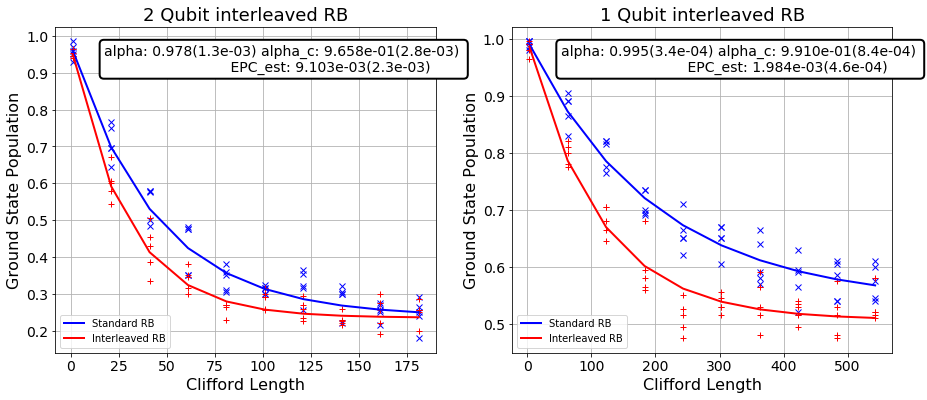

In [12]:
#Plot the joint RB data
plt.figure(figsize=(15, 6))

for i in range(2):
    ax = plt.subplot(1, 2, i+1)
    pattern_ind = i

    # Plot the essence by calling plot_rb_data
    joint_rb_fit.plot_interleaved_rb_data(pattern_ind, ax=ax, add_label=True, show_plt=False)

    # Add title and label
    ax.set_title('%d Qubit interleaved RB'%(len(rb_opts['rb_pattern'][i])), fontsize=18)

plt.show()

### Run process tomography on the interleaved gates

In [13]:
from qiskit import QuantumRegister, QuantumCircuit, Aer
from qiskit.quantum_info import state_fidelity
from qiskit.tools.qi.qi import outer
import qiskit.ignis.verification.tomography as tomo

# Print the interleaved gates
for gatelist in interleaved_gates:
    print (gatelist)
    
# Prepare the two circuits for the process tomography
# Create the 2-qubit circuit
q2 = QuantumRegister(2)
circ2 = QuantumCircuit(q2)
circ2.h(q2[0])
circ2.cx(q2[0], q2[1])
print(circ2)

# Create the 1-qubit circuit
q1 = QuantumRegister(1)
circ1 = QuantumCircuit(q1)
circ1.x(q1[0])
print (circ1)

['h 0', 'cx 0 1']
['x 0']
             ┌───┐     
q11060_0: |0>┤ H ├──■──
             └───┘┌─┴─┐
q11060_1: |0>─────┤ X ├
                  └───┘
             ┌───┐
q11061_0: |0>┤ X ├
             └───┘


#### Process tomography on the 2-qubit gate

In [14]:
# Run circuit on unitary simulator to find ideal unitary
job = qiskit.execute(circ2, Aer.get_backend('unitary_simulator'))
ideal_unitary = job.result().get_unitary(circ2)
# convert to Choi-matrix in column-major convention
choi_ideal = outer(ideal_unitary.ravel(order='F'))

# Generate process tomography circuits and run on qasm simulator
qpt_circs = tomo.process_tomography_circuits(circ2, q2)
job = qiskit.execute(qpt_circs, Aer.get_backend('qasm_simulator'), shots=2000)

# Extract tomography data so that counts are indexed by measurement configuration
qpt_tomo = tomo.ProcessTomographyFitter(job.result(), qpt_circs)

t = time.time()
choi_lstsq = qpt_tomo.fit(method='lstsq')
print('Least-Sq Fitter')
print('fit time:', time.time() - t)
print('fit fidelity:', state_fidelity(choi_ideal / 4, choi_lstsq.data / 4))
print('1 - fit fidelity:', 1-state_fidelity(choi_ideal / 4, choi_lstsq.data / 4))

t = time.time()
choi_cvx = qpt_tomo.fit(method='cvx')
print('\nCVXOPT Fitter')
print('fit time:', time.time() - t)
print('fit fidelity:', state_fidelity(choi_ideal / 4, choi_cvx.data / 4))
print('1 - fit fidelity:', 1-state_fidelity(choi_ideal / 4, choi_cvx.data / 4))

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/circuits.py:266: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  meas_qubit_registers = set(q[0] for q in meas_qubits)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/circuits.py:266: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  meas_qubit_registers = set(q[0] for q in meas_qubits)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/circuits.py:273: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  prep_qubit_registers = set(q[0] for q in prep_qubits)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/circuits.py:273: DeprecationWarning: Accessing a 

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/paulibasis.py:44: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  circ = QuantumCircuit(qubit[0], clbit[0])
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/paulibasis.py:44: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  circ = QuantumCircuit(qubit[0], clbit[0])
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/paulibasis.py:44: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  circ = QuantumCircuit(qubit[0], clbit[0])
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/paulibasis.py:44: DeprecationWarning: Accessing a bit register by bit[0] or its in

Least-Sq Fitter
fit time: 0.2129368782043457
fit fidelity: 0.984905557665798
1 - fit fidelity: 0.015094442334201985

CVXOPT Fitter
fit time: 1.872633695602417
fit fidelity: 0.9999108000134169
1 - fit fidelity: 8.919998658307726e-05


#### Process tomography on the 1-qubit gate

In [16]:
# Run circuit on unitary simulator to find ideal unitary
job = qiskit.execute(circ1, Aer.get_backend('unitary_simulator'))
ideal_unitary = job.result().get_unitary(circ1)
# convert to Choi-matrix in column-major convention
choi_ideal = outer(ideal_unitary.ravel(order='F'))

# Generate process tomography circuits and run on qasm simulator
qpt_circs = tomo.process_tomography_circuits(circ1, q1)
job = qiskit.execute(qpt_circs, Aer.get_backend('qasm_simulator'), shots=4000)

# Extract tomography data so that counts are indexed by measurement configuration
qpt_tomo = tomo.ProcessTomographyFitter(job.result(), qpt_circs)
qpt_tomo.data

# MLE Least-Squares tomographic reconstruction
t = time.time()
choi_lstsq = qpt_tomo.fit(method='lstsq')
print('Least-Sq Fitter')
print('fit time:', time.time() - t)
print('fit fidelity:', state_fidelity(choi_ideal / 2, choi_lstsq.data / 2))
print('1 - fit fidelity:', 1-state_fidelity(choi_ideal / 2, choi_lstsq.data / 2))

# CVXOPT Semidefinite-Program tomographic reconstruction
t = time.time()
choi_cvx = qpt_tomo.fit(method='cvx')
print('\nCVXOPT Fitter')
print('fit time:', time.time() - t)
print('fit fidelity:', state_fidelity(choi_ideal / 2, choi_cvx.data / 2))
print('1 - fit fidelity:', 1-state_fidelity(choi_ideal / 2, choi_cvx.data / 2))

/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/circuits.py:266: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  meas_qubit_registers = set(q[0] for q in meas_qubits)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/circuits.py:273: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  prep_qubit_registers = set(q[0] for q in prep_qubits)
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/paulibasis.py:71: DeprecationWarning: Accessing a bit register by bit[0] or its index by bit[1] is deprecated. Go for bit.register and bit.index.
  circ = QuantumCircuit(qubit[0])
/gpfs/haifa/projects/q/qq/team/shelly/ignis/qiskit/ignis/verification/tomography/basis/paulibasis.py:44: DeprecationWarning: Accessing a bit register by bit[

Least-Sq Fitter
fit time: 0.013251781463623047
fit fidelity: 0.992340507945104
1 - fit fidelity: 0.007659492054896022

CVXOPT Fitter
fit time: 0.1381840705871582
fit fidelity: 0.9999830601171563
1 - fit fidelity: 1.6939882843680643e-05
